##### Copyright 2023 The MediaPipe Authors. All Rights Reserved.

In [12]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Hand Landmarks Detection with MediaPipe Tasks

This notebook shows you how to use MediaPipe Tasks Python API to detect hand landmarks from images.

## Preparation

Let's start with installing MediaPipe.

In [13]:
%pip install -q mediapipe

45161.77s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Note: you may need to restart the kernel to use updated packages.


Then download an off-the-shelf model bundle. Check out the [MediaPipe documentation](https://developers.google.com/mediapipe/solutions/vision/hand_landmarker#models) for more information about this model bundle.

In [14]:
!curl -O https://storage.googleapis.com/mediapipe-models/hand_landmarker/hand_landmarker/float16/1/hand_landmarker.task

45169.28s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 7635k  100 7635k    0     0  8347k      0 --:--:-- --:--:-- --:--:-- 8400k


## Visualization utilities

In [15]:
#@markdown We implemented some functions to visualize the hand landmark detection results. <br/> Run the following cell to activate the functions.

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np

MARGIN = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
HANDEDNESS_TEXT_COLOR = (88, 205, 54) # vibrant green

def draw_landmarks_on_image(rgb_image, detection_result):
  hand_landmarks_list = detection_result.hand_landmarks
  handedness_list = detection_result.handedness
  annotated_image = np.copy(rgb_image)

  # Loop through the detected hands to visualize.
  for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # Draw the hand landmarks.
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])
    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      hand_landmarks_proto,
      solutions.hands.HAND_CONNECTIONS,
      solutions.drawing_styles.get_default_hand_landmarks_style(),
      solutions.drawing_styles.get_default_hand_connections_style())

    # Get the top left corner of the detected hand's bounding box.
    height, width, _ = annotated_image.shape
    y_coordinates = [landmark.x for landmark in hand_landmarks]
    x_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - MARGIN

    # Draw handedness (left or right hand) on the image.
    cv2.putText(annotated_image, f"{handedness[0].category_name}",
                (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX,
                FONT_SIZE, HANDEDNESS_TEXT_COLOR, FONT_THICKNESS, cv2.LINE_AA)

  return annotated_image

## Download test image

Let's grab a test image that we'll use later. The image is from [Unsplash](https://unsplash.com/photos/mt2fyrdXxzk).

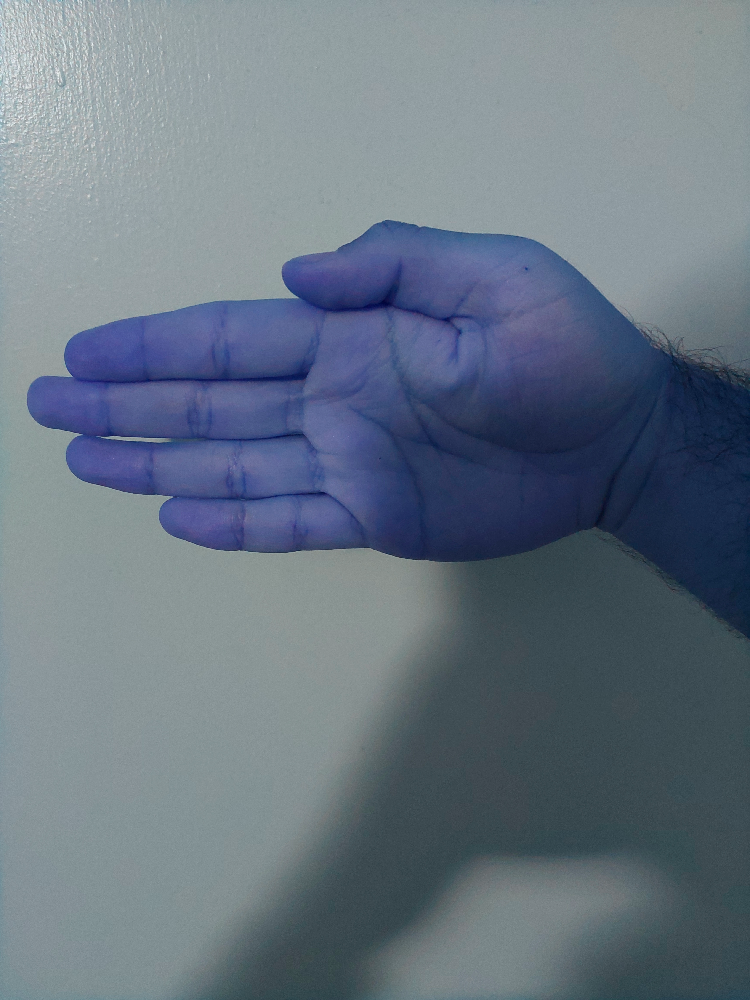

In [16]:
#!curl -o image.jpg https://storage.googleapis.com/mediapipe-tasks/hand_landmarker/woman_hands.jpg

import cv2
# from google.colab.patches import cv2_imshow
# from IPython.display import Image
from PIL import Image


img = cv2.imread("image.jpg")
#img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
Image.fromarray(img)
# cv2_imshow(img)

Optionally, you can upload your own image. If you want to do so, uncomment and run the cell below.

In [17]:
# from google.colab import files
# uploaded = files.upload()

# for filename in uploaded:
#   content = uploaded[filename]
#   with open(filename, 'wb') as f:
#     f.write(content)

# if len(uploaded.keys()):
#   IMAGE_FILE = next(iter(uploaded))
#   print('Uploaded file:', IMAGE_FILE)

## Running inference and visualizing the results

Here are the steps to run hand landmark detection using MediaPipe.

Check out the [MediaPipe documentation](https://developers.google.com/mediapipe/solutions/vision/hand_landmarker/python) to learn more about configuration options that this solution supports.


In [21]:
# STEP 1: Import the necessary modules.
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from IPython.display import display

# STEP 2: Create an HandLandmarker object.
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(base_options=base_options,
                                       num_hands=2)
detector = vision.HandLandmarker.create_from_options(options)

# STEP 3: Load the input image.
image = mp.Image.create_from_file("image.jpg")

# STEP 4: Detect hand landmarks from the input image.
detection_result = detector.detect(image)

# STEP 5: Process the classification result. In this case, visualize it.
annotated_image = draw_landmarks_on_image(img, detection_result)
# cv2_imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
Image.fromarray(annotated_image)

I0000 00:00:1725920522.624879 7446997 gl_context.cc:357] GL version: 2.1 (2.1 ATI-5.5.17), renderer: AMD Radeon Pro 5300M OpenGL Engine
W0000 00:00:1725920522.648626 7615394 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1725920522.670225 7615394 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


array([[[155, 192, 212],
        [155, 190, 210],
        [161, 194, 214],
        ...,
        [134, 148, 147],
        [131, 145, 144],
        [133, 147, 146]],

       [[156, 193, 213],
        [156, 191, 211],
        [161, 194, 214],
        ...,
        [134, 148, 147],
        [131, 145, 144],
        [131, 145, 144]],

       [[163, 198, 218],
        [161, 196, 216],
        [162, 195, 214],
        ...,
        [136, 150, 149],
        [134, 148, 147],
        [132, 146, 145]],

       ...,

       [[111, 140, 147],
        [112, 141, 148],
        [112, 140, 147],
        ...,
        [ 44,  73,  87],
        [ 42,  71,  85],
        [ 42,  71,  85]],

       [[107, 136, 143],
        [107, 136, 143],
        [108, 137, 144],
        ...,
        [ 42,  71,  85],
        [ 40,  69,  83],
        [ 40,  69,  83]],

       [[101, 130, 137],
        [102, 131, 138],
        [106, 135, 142],
        ...,
        [ 45,  74,  88],
        [ 41,  70,  84],
        [ 41,  70,  84]]

In [19]:
detection_result

HandLandmarkerResult(handedness=[[Category(index=0, score=0.9815393090248108, display_name='Right', category_name='Right')]], hand_landmarks=[[NormalizedLandmark(x=0.44862818717956543, y=0.18581345677375793, z=9.573888064551284e-07, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.342389315366745, y=0.22779536247253418, z=-0.12375405430793762, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.2837750017642975, y=0.3483584523200989, z=-0.17188504338264465, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.263131707906723, y=0.46443861722946167, z=-0.20348414778709412, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.27534663677215576, y=0.5901146531105042, z=-0.23413677513599396, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.3434586524963379, y=0.5337473750114441, z=-0.07921560108661652, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.34071341156959534, y=0.6932615637779236, z=-0.1109757125377655, visibility=0.0, presence=0.0), NormalizedLandmark(x=0.3386